In [1]:
import os
import json
import cv2
import numpy as np
import random
import shutil
from tqdm import tqdm
import matplotlib.pyplot as plt
from ultralytics import YOLO
import albumentations as A
import labelme

In [2]:
# Base paths
BASE_DIR = "D:/projects_ml/Camouflage_Weapon_Detection"
DATA_DIR = os.path.join(BASE_DIR, "data")
RAW_DATA_DIR = os.path.join(DATA_DIR, "raw_data")
LABELED_DATA_DIR = os.path.join(DATA_DIR, "labeled_data")
DATASET_DIR = os.path.join(DATA_DIR, "dataset")
COMBINED_DIR = os.path.join(DATA_DIR, "combined_dataset")

# Raw data paths
WEAPON_DIR = os.path.join(RAW_DATA_DIR, "camouflaged_weapon")
NO_WEAPON_DIR = os.path.join(RAW_DATA_DIR, "normal_scenes")

# Labeled data paths
LABELED_IMAGES_DIR = os.path.join(LABELED_DATA_DIR, "images")
LABELED_LABELS_DIR = os.path.join(LABELED_DATA_DIR, "labels")

# Combined dataset paths
COMBINED_IMAGES_DIR = os.path.join(COMBINED_DIR, "images")
COMBINED_LABELS_DIR = os.path.join(COMBINED_DIR, "labels")

# Dataset paths for YOLOv8
TRAIN_IMAGES_DIR = os.path.join(DATASET_DIR, "train", "images")
TRAIN_LABELS_DIR = os.path.join(DATASET_DIR, "train", "labels")
VAL_IMAGES_DIR = os.path.join(DATASET_DIR, "val", "images")
VAL_LABELS_DIR = os.path.join(DATASET_DIR, "val", "labels")
TEST_IMAGES_DIR = os.path.join(DATASET_DIR, "test", "images")
TEST_LABELS_DIR = os.path.join(DATASET_DIR, "test", "labels")

# Create directories if they don't exist
os.makedirs(COMBINED_IMAGES_DIR, exist_ok=True)
os.makedirs(COMBINED_LABELS_DIR, exist_ok=True)
os.makedirs(TRAIN_IMAGES_DIR, exist_ok=True)
os.makedirs(TRAIN_LABELS_DIR, exist_ok=True)
os.makedirs(VAL_IMAGES_DIR, exist_ok=True)
os.makedirs(VAL_LABELS_DIR, exist_ok=True)
os.makedirs(TEST_IMAGES_DIR, exist_ok=True)
os.makedirs(TEST_LABELS_DIR, exist_ok=True)

In [4]:
!labelme

2025-03-15 11:29:18.099 | INFO     | labelme.config:get_config:66 - Loading config file from: C:\Users\sssee\.labelmerc


In [9]:
import os
import json
import cv2
import shutil

# Define directory paths (adjust these to match your project)
NORMAL_SCENES_DIR = "D:/projects_ml/Camouflage_Weapon_Detection/data/raw_data/normal_scenes"
LABELED_IMAGES_DIR = "D:/projects_ml/Camouflage_Weapon_Detection/data/labeled_data/images"
LABELED_LABELS_DIR = "D:/projects_ml/Camouflage_Weapon_Detection/data/labeled_data/labels"

# Ensure destination directories exist
os.makedirs(LABELED_IMAGES_DIR, exist_ok=True)
os.makedirs(LABELED_LABELS_DIR, exist_ok=True)

# Process each image in normal_scenes/
for img_file in os.listdir(NORMAL_SCENES_DIR):
    if img_file.lower().endswith(('.jpg', '.png','.jpeg')):  # Support jpg and png
        # Define source and destination paths for the image
        src_img_path = os.path.join(NORMAL_SCENES_DIR, img_file)
        dst_img_path = os.path.join(LABELED_IMAGES_DIR, img_file)

        # Copy the image to labeled_data/images/
        shutil.copy(src_img_path, dst_img_path)

        # Read image dimensions
        img = cv2.imread(dst_img_path)
        if img is None:
            print(f"Failed to load {img_file}. Skipping...")
            continue
        height, width = img.shape[:2]

        # Create empty Labelme JSON structure
        json_data = {
            "version": "5.4.1",  # Adjust if you use a different Labelme version
            "flags": {},
            "shapes": [],        # Empty list for no annotations
            "imagePath": img_file,
            "imageData": None,
            "imageHeight": height,
            "imageWidth": width
        }

        # Define JSON filename (replace image extension with .json)
        json_file = os.path.splitext(img_file)[0] + ".json"
        json_path = os.path.join(LABELED_LABELS_DIR, json_file)

        # Save the JSON file
        with open(json_path, 'w') as f:
            json.dump(json_data, f, indent=2)

        print(f"Created {json_file} for {img_file}")

print("Finished creating empty JSON files for normal scenes.")

Created ns1.json for ns1.jpg
Created ns10.json for ns10.jpg
Created ns11.json for ns11.jpg
Created ns12.json for ns12.jpg
Created ns13.json for ns13.jpg
Created ns14.json for ns14.jpg
Created ns15.json for ns15.jpg
Created ns16.json for ns16.jpg
Created ns17.json for ns17.jpg
Created ns18.json for ns18.jpg
Created ns19.json for ns19.jpg
Created ns2.json for ns2.jpg
Created ns20.json for ns20.jpg
Created ns21.json for ns21.jpeg
Created ns22.json for ns22.jpeg
Created ns22.json for ns22.jpg
Created ns23.json for ns23.jpg
Created ns24.json for ns24.jpg
Created ns25.json for ns25.jpg
Created ns26.json for ns26.jpg
Created ns27.json for ns27.jpg
Created ns28.json for ns28.jpeg
Created ns29.json for ns29.jpg
Created ns3.json for ns3.jpg
Created ns30.json for ns30.jpg
Created ns31.json for ns31.jpg
Created ns32.json for ns32.jpg
Created ns33.json for ns33.jpg
Created ns4.json for ns4.jpg
Created ns5.json for ns5.jpg
Created ns6.json for ns6.jpg
Created ns7.json for ns7.jpg
Created ns8.json fo

In [10]:
# Define class mapping
CLASS_MAPPING = {
    "Weapon": 0,
    "No Weapon": 1
}

In [11]:
def convert_labelme_to_yolo(json_file, img_width, img_height):
    """
    Convert LabelMe annotation to YOLO format
    
    Returns:
        list: List of YOLO annotations [class_id, x_center, y_center, width, height]
    """
    with open(json_file, 'r') as f:
        data = json.load(f)
    
    yolo_annotations = []
    
    for shape in data['shapes']:
        label = shape['label']
        if label in CLASS_MAPPING:
            class_id = CLASS_MAPPING[label]
            points = shape['points']
            
            # Calculate bounding box from polygon points
            x_coords = [point[0] for point in points]
            y_coords = [point[1] for point in points]
            
            x_min, x_max = min(x_coords), max(x_coords)
            y_min, y_max = min(y_coords), max(y_coords)
            
            # Convert to YOLO format (normalized values)
            x_center = (x_min + x_max) / 2 / img_width
            y_center = (y_min + y_max) / 2 / img_height
            width = (x_max - x_min) / img_width
            height = (y_max - y_min) / img_height
            
            yolo_annotations.append([class_id, x_center, y_center, width, height])
    
    return yolo_annotations

In [36]:
def process_labelme_annotations():
    """Process all LabelMe annotations and convert to YOLO format"""
    json_files = [f for f in os.listdir(LABELED_LABELS_DIR) if f.endswith('.json')]
    
    for json_file in tqdm(json_files, desc="Converting LabelMe to YOLO"):
        # Get corresponding image file
        img_file = json_file.replace('.json', '.jpg')
        img_path = os.path.join(LABELED_IMAGES_DIR, img_file)
        
        # If jpg doesn't exist, try png
        if not os.path.exists(img_path):
            img_file = json_file.replace('.json', '.png')
            img_path = os.path.join(LABELED_IMAGES_DIR, img_file)


        if not os.path.exists(img_path):
            img_file = json_file.replace('.json', '.jpeg')
            img_path = os.path.join(LABELED_IMAGES_DIR, img_file)

        
        if not os.path.exists(img_path):
            print(f"Image for {json_file} not found. Skipping...")
            continue
        
        # Read image to get dimensions
        img = cv2.imread(img_path)
        img_height, img_width = img.shape[:2]
        
        # Convert to YOLO format
        json_path = os.path.join(LABELED_LABELS_DIR, json_file)
        yolo_annotations = convert_labelme_to_yolo(json_path, img_width, img_height)
        
        # Save YOLO annotations
        yolo_file = json_file.replace('.json', '.txt')
        yolo_path = os.path.join(LABELED_LABELS_DIR, yolo_file)
        
        with open(yolo_path, 'w') as f:
            for annotation in yolo_annotations:
                f.write(' '.join(map(str, annotation)) + '\n')
        
        # Copy image to combined dataset
        dst_img_path = os.path.join(COMBINED_IMAGES_DIR, img_file)
        shutil.copy(img_path, dst_img_path)
        
        # Copy label to combined dataset
        dst_label_path = os.path.join(COMBINED_LABELS_DIR, yolo_file)
        shutil.copy(yolo_path, dst_label_path)
        
    print(f"Converted {len(json_files)} LabelMe annotations to YOLO format.")

In [38]:
def get_augmentation_pipeline():
    """Define augmentation pipeline"""
    return A.Compose([
        # Geometric transformations
        A.RandomResizedCrop(size=(640, 640), scale=(0.8, 1.0), p=0.7),  # Updated line
        A.Rotate(limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.1),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, p=0.5),
        
        # Color transformations
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.7),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=0.5),
        A.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=0.5),
        A.GaussNoise(var_limit=(10.0, 50.0), p=0.4),
        A.GaussianBlur(blur_limit=5, p=0.3),
        
        # Weather and texture transformations
        A.RandomFog(fog_coef_lower=0.1, fog_coef_upper=0.3, p=0.2),
        A.RandomShadow(shadow_roi=(0, 0, 1, 1), p=0.2),
        A.RandomSunFlare(flare_roi=(0, 0, 1, 1), src_radius=100, p=0.1),
        
        # Camouflage-specific augmentations
        A.ToGray(p=0.2),
        A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), p=0.3),
        A.ImageCompression(quality_lower=75, quality_upper=95, p=0.3),
    ], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

In [26]:
def augment_data(target_count=500):
    """
    Augment data to reach target count per class
    """
    # Get all labeled images and their annotations
    image_files = [f for f in os.listdir(COMBINED_IMAGES_DIR) if f.endswith(('.jpg', '.png', '.jpeg'))]
    label_files = [f.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt') for f in image_files]
    
    # Count images per class
    class_counts = {0: 0, 1: 0}  # {Weapon: 0, No Weapon: 0}
    image_classes = {}  # Map image name to class
    
    for img_file, label_file in zip(image_files, label_files):
        label_path = os.path.join(COMBINED_LABELS_DIR, label_file)
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                lines = f.readlines()
                if lines:
                    # Use the first annotation's class as the image class
                    class_id = int(lines[0].split()[0])
                    class_counts[class_id] += 1
                    image_classes[img_file] = class_id
                else:
                    # If no annotations, assume "No Weapon" (class 1)
                    class_counts[1] += 1
                    image_classes[img_file] = 1
        else:
            # If no label file, assume "No Weapon" (class 1)
            class_counts[1] += 1
            image_classes[img_file] = 1
    
    print(f"Initial class counts: Weapon: {class_counts[0]}, No Weapon: {class_counts[1]}")
    
    # Get augmentation pipeline
    transform = get_augmentation_pipeline()
    
    # Augment images for each class
    for class_id in [0, 1]:  # Weapon, No Weapon
        class_name = "Weapon" if class_id == 0 else "No Weapon"
        augmentations_needed = max(0, target_count - class_counts[class_id])
        
        print(f"Generating {augmentations_needed} augmented images for class '{class_name}'")
        
        # Get images for this class
        class_images = [img for img, cls in image_classes.items() if cls == class_id]
        
        if not class_images:
            print(f"No images found for class '{class_name}'. Skipping augmentation.")
            continue
        
        # Generate augmentations
        for i in tqdm(range(augmentations_needed), desc=f"Augmenting {class_name}"):
            # Choose a random image
            img_file = random.choice(class_images)
            img_path = os.path.join(COMBINED_IMAGES_DIR, img_file)
            label_file = img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
            label_path = os.path.join(COMBINED_LABELS_DIR, label_file)
            
            # Read image
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Read annotations
            bboxes = []
            class_labels = []
            
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if len(parts) == 5:
                            class_id, x_center, y_center, width, height = map(float, parts)
                            bboxes.append([x_center, y_center, width, height])
                            class_labels.append(int(class_id))
            
            # Apply augmentation
            augmented = transform(image=img, bboxes=bboxes, class_labels=class_labels)
            augmented_img = augmented['image']
            augmented_bboxes = augmented['bboxes']
            augmented_labels = augmented['class_labels']
            
            # Save augmented image
            aug_img_file = f"aug_{i}_{img_file}"
            aug_img_path = os.path.join(COMBINED_IMAGES_DIR, aug_img_file)
            cv2.imwrite(aug_img_path, cv2.cvtColor(augmented_img, cv2.COLOR_RGB2BGR))
            
            # Save augmented annotations
            aug_label_file = aug_img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
            aug_label_path = os.path.join(COMBINED_LABELS_DIR, aug_label_file)
            
            with open(aug_label_path, 'w') as f:
                for bbox, label in zip(augmented_bboxes, augmented_labels):
                    f.write(f"{label} {' '.join(map(str, bbox))}\n")
            
            # Show example augmented image (every 50 iterations)
            if i % 50 == 0:
                plt.figure(figsize=(10, 10))
                plt.imshow(augmented_img)
                plt.title(f"Augmented {class_name} Image")
                for bbox, label in zip(augmented_bboxes, augmented_labels):
                    x_center, y_center, width, height = bbox
                    x_min = int((x_center - width/2) * augmented_img.shape[1])
                    y_min = int((y_center - height/2) * augmented_img.shape[0])
                    x_max = int((x_center + width/2) * augmented_img.shape[1])
                    y_max = int((y_center + height/2) * augmented_img.shape[0])
                    
                    label_name = "Weapon" if label == 0 else "No Weapon"
                    plt.gca().add_patch(plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                                    fill=False, edgecolor='red', linewidth=2))
                    plt.gca().text(x_min, y_min - 5, label_name, color='red')
                plt.show()
    
    # Count final images
    final_image_count = len([f for f in os.listdir(COMBINED_IMAGES_DIR) if f.endswith(('.jpg', '.png', '.jpeg'))])
    print(f"Final dataset size: {final_image_count} images")
    
    return final_image_count

In [27]:
def split_dataset(train_ratio=0.7, val_ratio=0.2, test_ratio=0.1):
    """
    Split the combined dataset into train, validation, and test sets
    """
    assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 1e-10, "Ratios must sum to 1"
    
    # Get all image files from combined dataset
    image_files = [f for f in os.listdir(COMBINED_IMAGES_DIR) if f.endswith(('.jpg', '.png', '.jpeg'))]
    random.shuffle(image_files)
    
    # Calculate split indices
    train_end = int(len(image_files) * train_ratio)
    val_end = train_end + int(len(image_files) * val_ratio)
    
    # Split the dataset
    train_files = image_files[:train_end]
    val_files = image_files[train_end:val_end]
    test_files = image_files[val_end:]
    
    print(f"Dataset split: {len(train_files)} train, {len(val_files)} validation, {len(test_files)} test")
    
    # Copy files to respective directories
    for img_file in tqdm(train_files, desc="Copying train files"):
        # Copy image
        src_img_path = os.path.join(COMBINED_IMAGES_DIR, img_file)
        dst_img_path = os.path.join(TRAIN_IMAGES_DIR, img_file)
        shutil.copy(src_img_path, dst_img_path)
        
        # Copy label
        label_file = img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
        src_label_path = os.path.join(COMBINED_LABELS_DIR, label_file)
        dst_label_path = os.path.join(TRAIN_LABELS_DIR, label_file)
        if os.path.exists(src_label_path):
            shutil.copy(src_label_path, dst_label_path)
    
    for img_file in tqdm(val_files, desc="Copying validation files"):
        # Copy image
        src_img_path = os.path.join(COMBINED_IMAGES_DIR, img_file)
        dst_img_path = os.path.join(VAL_IMAGES_DIR, img_file)
        shutil.copy(src_img_path, dst_img_path)
        
        # Copy label
        label_file = img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
        src_label_path = os.path.join(COMBINED_LABELS_DIR, label_file)
        dst_label_path = os.path.join(VAL_LABELS_DIR, label_file)
        if os.path.exists(src_label_path):
            shutil.copy(src_label_path, dst_label_path)
    
    for img_file in tqdm(test_files, desc="Copying test files"):
        # Copy image
        src_img_path = os.path.join(COMBINED_IMAGES_DIR, img_file)
        dst_img_path = os.path.join(TEST_IMAGES_DIR, img_file)
        shutil.copy(src_img_path, dst_img_path)
        
        # Copy label
        label_file = img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
        src_label_path = os.path.join(COMBINED_LABELS_DIR, label_file)
        dst_label_path = os.path.join(TEST_LABELS_DIR, label_file)
        if os.path.exists(src_label_path):
            shutil.copy(src_label_path, dst_label_path)
    
    return len(train_files), len(val_files), len(test_files)

In [31]:
def show_augmentation_examples():
    """
    Show examples of augmentations
    """
    # Get a sample image from labeled data
    image_files = [f for f in os.listdir(LABELED_IMAGES_DIR) if f.endswith(('.jpg', '.png', '.jpeg'))]
    
    if not image_files:
        print("No labeled images found.")
        return
    
    img_file = random.choice(image_files)
    img_path = os.path.join(LABELED_IMAGES_DIR, img_file)
    label_file = img_file.replace('.jpg', '.txt').replace('.png', '.txt').replace('.jpeg', '.txt')
    label_path = os.path.join(LABELED_LABELS_DIR, label_file.replace('.txt', '.json'))
    
    # Get augmentation pipeline
    transform = get_augmentation_pipeline()
    
    # Read image
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Read annotations if they exist
    bboxes = []
    class_labels = []
    
    if os.path.exists(label_path):
        # Try to read YOLO format
        yolo_label_path = os.path.join(LABELED_LABELS_DIR, label_file)
        if os.path.exists(yolo_label_path):
            with open(yolo_label_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) == 5:
                        class_id, x_center, y_center, width, height = map(float, parts)
                        bboxes.append([x_center, y_center, width, height])
                        class_labels.append(int(class_id))
        # If no YOLO format, try LabelMe JSON
        else:
            try:
                with open(label_path, 'r') as f:
                    data = json.load(f)
                
                for shape in data['shapes']:
                    label = shape['label']
                    if label in CLASS_MAPPING:
                        class_id = CLASS_MAPPING[label]
                        points = shape['points']
                        
                        # Calculate bounding box from polygon points
                        x_coords = [point[0] for point in points]
                        y_coords = [point[1] for point in points]
                        
                        x_min, x_max = min(x_coords), max(x_coords)
                        y_min, y_max = min(y_coords), max(y_coords)
                        
                        # Convert to YOLO format (normalized values)
                        x_center = (x_min + x_max) / 2 / img.shape[1]
                        y_center = (y_min + y_max) / 2 / img.shape[0]
                        width = (x_max - x_min) / img.shape[1]
                        height = (y_max - y_min) / img.shape[0]
                        
                        bboxes.append([x_center, y_center, width, height])
                        class_labels.append(class_id)
            except:
                print(f"Failed to read annotation file: {label_path}")
    
    # Show original image
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title("Original Image")
    
    # Draw bounding boxes on original image
    for bbox, label in zip(bboxes, class_labels):
        x_center, y_center, width, height = bbox
        x_min = int((x_center - width/2) * img.shape[1])
        y_min = int((y_center - height/2) * img.shape[0])
        x_max = int((x_center + width/2) * img.shape[1])
        y_max = int((y_center + height/2) * img.shape[0])
        
        label_name = "Weapon" if label == 0 else "No Weapon"
        plt.gca().add_patch(plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                        fill=False, edgecolor='red', linewidth=2))
        plt.gca().text(x_min, y_min - 5, label_name, color='red')
    
    # Apply augmentation
    if bboxes and class_labels:
        augmented = transform(image=img, bboxes=bboxes, class_labels=class_labels)
        augmented_img = augmented['image']
        augmented_bboxes = augmented['bboxes']
        augmented_labels = augmented['class_labels']
        
        # Show augmented image
        plt.subplot(1, 2, 2)
        plt.imshow(augmented_img)
        plt.title("Augmented Image")
        
        # Draw bounding boxes on augmented image
        for bbox, label in zip(augmented_bboxes, augmented_labels):
            x_center, y_center, width, height = bbox
            x_min = int((x_center - width/2) * augmented_img.shape[1])
            y_min = int((y_center - height/2) * augmented_img.shape[0])
            x_max = int((x_center + width/2) * augmented_img.shape[1])
            y_max = int((y_center + height/2) * augmented_img.shape[0])
            
            label_name = "Weapon" if label == 0 else "No Weapon"
            plt.gca().add_patch(plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                            fill=False, edgecolor='green', linewidth=2))
            plt.gca().text(x_min, y_min - 5, label_name, color='green')
    else:
        # If no annotations, just show the augmented image
        augmented = transform(image=img)
        augmented_img = augmented['image']
        
        plt.subplot(1, 2, 2)
        plt.imshow(augmented_img)
        plt.title("Augmented Image (No Annotations)")
    
    plt.tight_layout()
    plt.show()

In [28]:
def create_dataset_yaml():
    """
    Create dataset.yaml file for YOLOv8 training
    """
    yaml_path = os.path.join(DATA_DIR, "dataset.yaml")
    
    yaml_content = f"""
# Camouflaged Weapon Detection dataset
path: {DATASET_DIR}
train: train/images
val: val/images
test: test/images

# Classes
names:
  0: Weapon
  1: No Weapon
"""
    
    with open(yaml_path, 'w') as f:
        f.write(yaml_content)
    
    print(f"Created dataset.yaml at {yaml_path}")
    return yaml_path

In [29]:
def train_yolov8(yaml_path, epochs=50):
    """
    Train YOLOv8 model
    """
    # Load YOLOv8n model
    model = YOLO('yolov8n.pt')
    
    # Train the model
    results = model.train(
        data=yaml_path,
        epochs=epochs,
        imgsz=640,
        batch=16,
        patience=15,
        save=True,
        project=os.path.join(BASE_DIR, "runs"),
        name="train"
    )
    
    print(f"Training completed. Results saved to {os.path.join(BASE_DIR, 'runs', 'train')}")
    return model

In [40]:
def test_model(model_path=None):
    """
    Test the trained model on test dataset
    """
    if model_path:
        # Load trained model
        model = YOLO(model_path)
    else:
        # Try to find the best model
        weights_dir = os.path.join(BASE_DIR, "runs", "train", "weights")
        if os.path.exists(weights_dir):
            best_pt = os.path.join(weights_dir, "best.pt")
            if os.path.exists(best_pt):
                print(f"Found trained model: {best_pt}")
                model = YOLO(best_pt)
            else:
                last_pt = os.path.join(weights_dir, "last.pt")
                if os.path.exists(last_pt):
                    print(f"Using last.pt instead of best.pt")
                    model = YOLO(last_pt)
                else:
                    print("No trained model found. Using default YOLOv8n.")
                    model = YOLO('yolov8n.pt')
        else:
            print("No training weights directory found. Using default YOLOv8n.")
            model = YOLO('yolov8n.pt')
    
    # Run validation
    results = model.val(data=os.path.join(DATA_DIR, "dataset.yaml"))
    print(f"Validation results: {results}")
    
    # Test on some images
    test_images = [os.path.join(TEST_IMAGES_DIR, f) for f in os.listdir(TEST_IMAGES_DIR) if f.endswith(('.jpg', '.png','.jpeg'))]
    
    if not test_images:
        print("No test images found.")
        return
    
    # Select a few random test images
    test_samples = random.sample(test_images, min(5, len(test_images)))
    
    for img_path in test_samples:
        # Perform prediction
        results = model.predict(img_path, conf=0.25)
        
        # Display results
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(12, 8))
        plt.imshow(img)
        
        # Draw bounding boxes
        for result in results:
            boxes = result.boxes
            for box in boxes:
                # Get coordinates
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                
                # Get class and confidence
                cls = int(box.cls[0].item())
                conf = box.conf[0].item()
                
                # Get class name
                class_name = "Weapon" if cls == 0 else "No Weapon"
                
                # Draw box
                plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, 
                                               fill=False, edgecolor='red', linewidth=2))
                plt.gca().text(x1, y1 - 10, f"{class_name} {conf:.2f}", color='red', fontsize=12)
        
        plt.title(f"Detection Result: {os.path.basename(img_path)}")
        plt.axis('off')
        plt.show()

In [32]:
def run_full_pipeline(augment_to=500, train_epochs=50):
    """
    Run the full pipeline from data preparation to model training and testing
    """
    print("Starting Camouflaged Weapon Detection Pipeline")
    print("="*50)
    
    # Step 1: Process LabelMe annotations
    print("\nStep 1: Processing LabelMe annotations")
    process_labelme_annotations()
    
    # Step 2: Show augmentation examples
    print("\nStep 2: Showing augmentation examples")
    show_augmentation_examples()
    
    # Step 3: Augment data
    print("\nStep 3: Augmenting data")
    augment_data(target_count=augment_to)
    
    # Step 4: Split dataset
    print("\nStep 4: Splitting dataset")
    split_dataset()
    
    # Step 5: Create dataset.yaml
    print("\nStep 5: Creating dataset.yaml")
    yaml_path = create_dataset_yaml()
    
    # Step 6: Train YOLOv8 model
    print("\nStep 6: Training YOLOv8 model")
    model = train_yolov8(yaml_path, epochs=train_epochs)
    
    # Step 7: Test model
    print("\nStep 7: Testing model")
    test_model()
    
    print("\nPipeline completed successfully!")

In [33]:
def detect_weapons(img_path=None, dir_path=None, conf_threshold=0.25):
    """
    Detect weapons in a single image or all images in a directory
    """
    # Load best model
    train_dir = os.path.join(BASE_DIR, "runs", "train")
    if os.path.exists(train_dir):
        # Find the latest run
        runs = sorted(os.listdir(train_dir), key=lambda x: os.path.getmtime(os.path.join(train_dir, x)), reverse=True)
        if runs:
            model_path = os.path.join(train_dir, runs[0], "weights", "best.pt")
            if os.path.exists(model_path):
                model = YOLO(model_path)
            else:
                print("Could not find best.pt, using last.pt")
                model_path = os.path.join(train_dir, runs[0], "weights", "last.pt")
                if os.path.exists(model_path):
                    model = YOLO(model_path)
                else:
                    print("No trained model found. Using default YOLOv8n.")
                    model = YOLO('yolov8n.pt')
        else:
            print("No training runs found. Using default YOLOv8n.")
            model = YOLO('yolov8n.pt')
    else:
        print("No training runs found. Using default YOLOv8n.")
        model = YOLO('yolov8n.pt')
    
    # Process single image
    if img_path:
        if not os.path.exists(img_path):
            print(f"Image not found: {img_path}")
            return
        
        # Perform prediction
        results = model.predict(img_path, conf=conf_threshold)
        
        # Display results
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(12, 8))
        plt.imshow(img)
        
        # Draw bounding boxes
        for result in results:
            boxes = result.boxes
            for box in boxes:
                # Get coordinates
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                
                # Get class and confidence
                cls = int(box.cls[0].item())
                conf = box.conf[0].item()
                
                # Get class name
                class_name = "Weapon" if cls == 0 else "No Weapon"
                
                # Draw box
                plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, 
                                               fill=False, edgecolor='red', linewidth=2))
                plt.gca().text(x1, y1 - 10, f"{class_name} {conf:.2f}", color='red', fontsize=12)
        
        plt.title(f"Detection Result: {os.path.basename(img_path)}")
        plt.axis('off')
        plt.show()
    
    # Process directory
    elif dir_path:
        if not os.path.exists(dir_path):
            print(f"Directory not found: {dir_path}")
            return
        
        image_files = [f for f in os.listdir(dir_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        
        if not image_files:
            print(f"No images found in directory: {dir_path}")
            return
        
        print(f"Processing {len(image_files)} images...")
        
        for img_file in image_files:
            img_path = os.path.join(dir_path, img_file)
            
            # Perform prediction
            results = model.predict(img_path, conf=conf_threshold)
            
            # Display results
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            plt.figure(figsize=(12, 8))
            plt.imshow(img)
            
            # Draw bounding boxes
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    # Get coordinates
                    x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                    
                    # Get class and confidence
                    cls = int(box.cls[0].item())
                    conf = box.conf[0].item()
                    
                    # Get class name
                    class_name = "Weapon" if cls == 0 else "No Weapon"
                    
                    # Draw box
                    plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, 
                                                   fill=False, edgecolor='red', linewidth=2))
                    plt.gca().text(x1, y1 - 10, f"{class_name} {conf:.2f}", color='red', fontsize=12)
            
            plt.title(f"Detection Result: {img_file}")
            plt.axis('off')
            plt.show()
    
    else:
        print("Please provide either an image path or directory path.")

In [43]:
def evaluate_model():
    """
    Evaluate the model and show performance metrics
    """
    # Load best model
    weights_dir = os.path.join(BASE_DIR, "runs", "train", "weights")
    if os.path.exists(weights_dir):
        best_pt = os.path.join(weights_dir, "best.pt")
        if os.path.exists(best_pt):
            print(f"Found trained model: {best_pt}")
            model = YOLO(best_pt)
        else:
            last_pt = os.path.join(weights_dir, "last.pt")
            if os.path.exists(last_pt):
                print(f"Using last.pt instead of best.pt")
                model = YOLO(last_pt)
            else:
                print("No trained model found. Using default YOLOv8n.")
                model = YOLO('yolov8n.pt')
    else:
        print("No training weights directory found. Using default YOLOv8n.")
        model = YOLO('yolov8n.pt')
    
    # Evaluate on validation set
    results = model.val(data=os.path.join(DATA_DIR, "dataset.yaml"))
    
    # Print metrics
    print("\nModel Evaluation Metrics:")
    print(f"mAP50: {results.box.map50:.4f}")
    print(f"mAP50-95: {results.box.map:.4f}")    
    # Return metrics
    return results

Starting Camouflaged Weapon Detection Pipeline

Step 1: Processing LabelMe annotations


Converting LabelMe to YOLO: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████| 65/65 [00:00<00:00, 75.16it/s]
D:\projects_ml\Camouflage_Weapon_Detection\cwd\lib\site-packages\albumentations\core\validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
C:\Users\sssee\AppData\Local\Temp\ipykernel_16316\2491894429.py:15: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  A.GaussNoise(var_limit=(10.0, 50.0), p=0.4),
C:\Users\sssee\AppData\Local\Temp\ipykernel_16316\2491894429.py:19: UserWarning: Argument(s) 'fog_coef_lower, fog_coef_upper' are not valid for transform RandomFog
  A.RandomFog(fog_coef_lower=0.1, fog_coef_upper=0.3, p=0.2),
C:\Users\sssee\AppData\Local\Temp\ipykernel_16316\2491894429.py:26: UserWarning: Argument(s) 'quality_lower, quality_upper' are not valid for transform ImageCom

Converted 65 LabelMe annotations to YOLO format.

Step 2: Showing augmentation examples


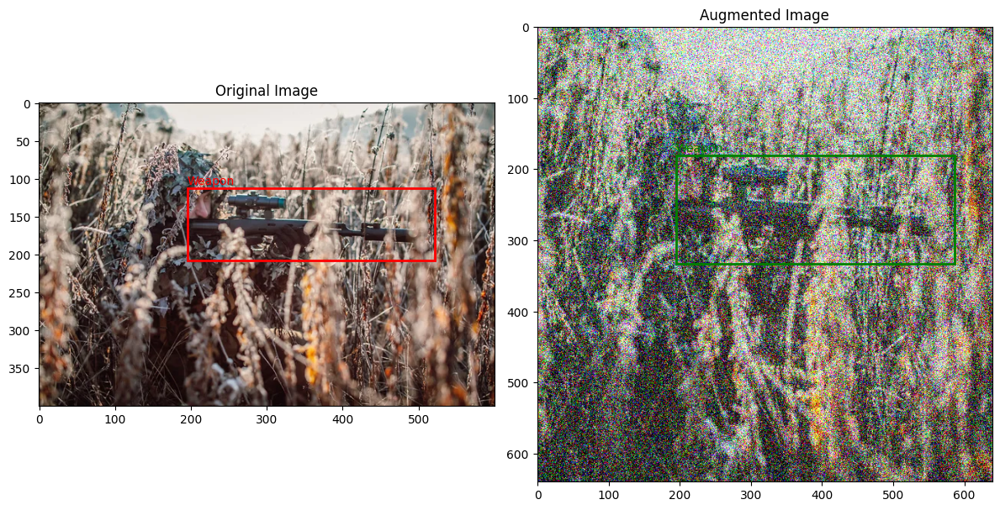


Step 3: Augmenting data
Initial class counts: Weapon: 32, No Weapon: 33
Generating 468 augmented images for class 'Weapon'


Augmenting Weapon:   0%|                                                                                                                           | 0/468 [00:00<?, ?it/s]

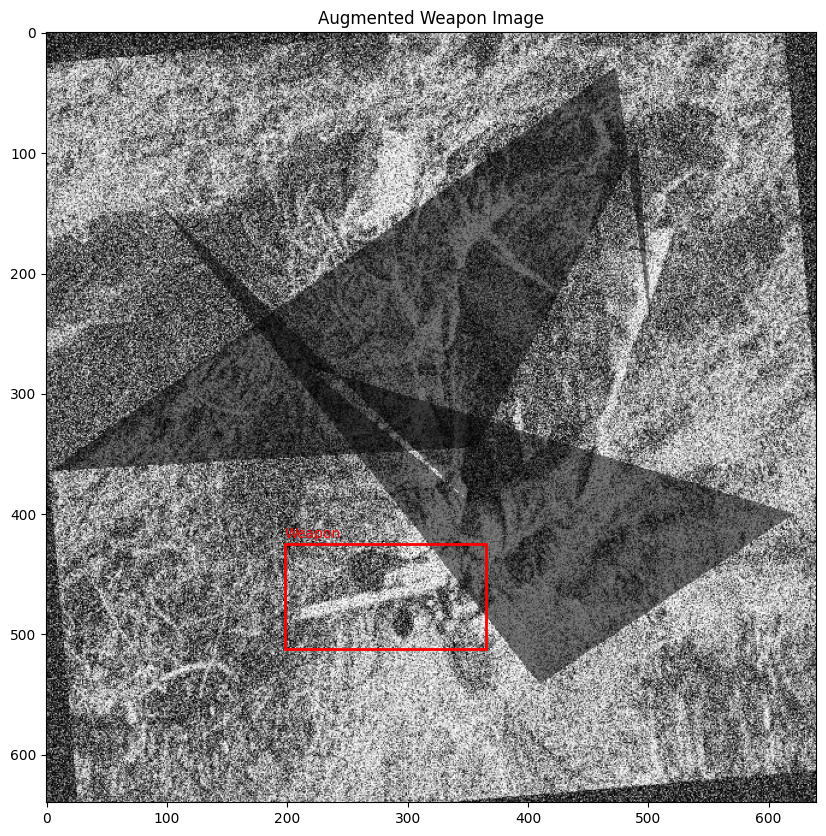

Augmenting Weapon:  10%|███████████▉                                                                                                      | 49/468 [00:12<00:42,  9.93it/s]

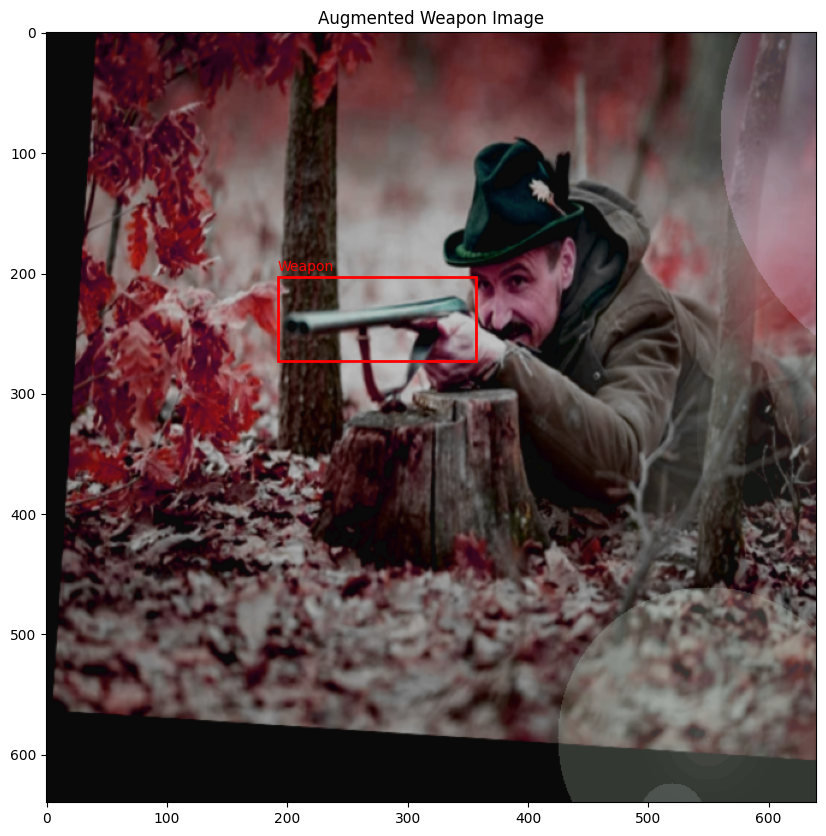

Augmenting Weapon:  21%|████████████████████████                                                                                          | 99/468 [00:17<00:25, 14.41it/s]

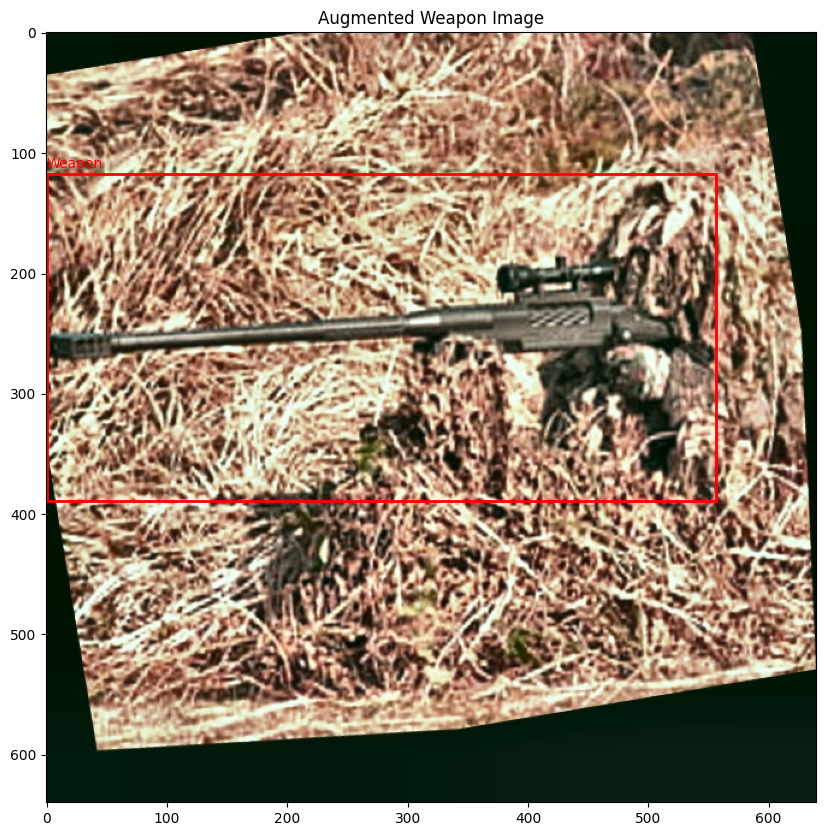

Augmenting Weapon:  32%|████████████████████████████████████▏                                                                            | 150/468 [00:24<00:30, 10.49it/s]

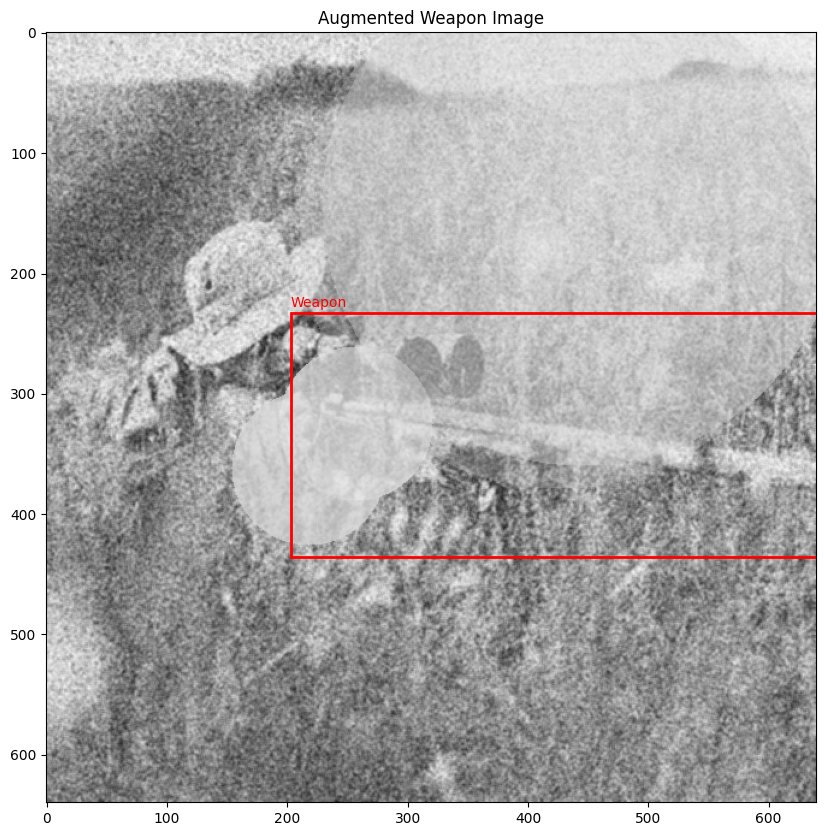

Augmenting Weapon:  43%|████████████████████████████████████████████████                                                                 | 199/468 [00:37<00:46,  5.73it/s]

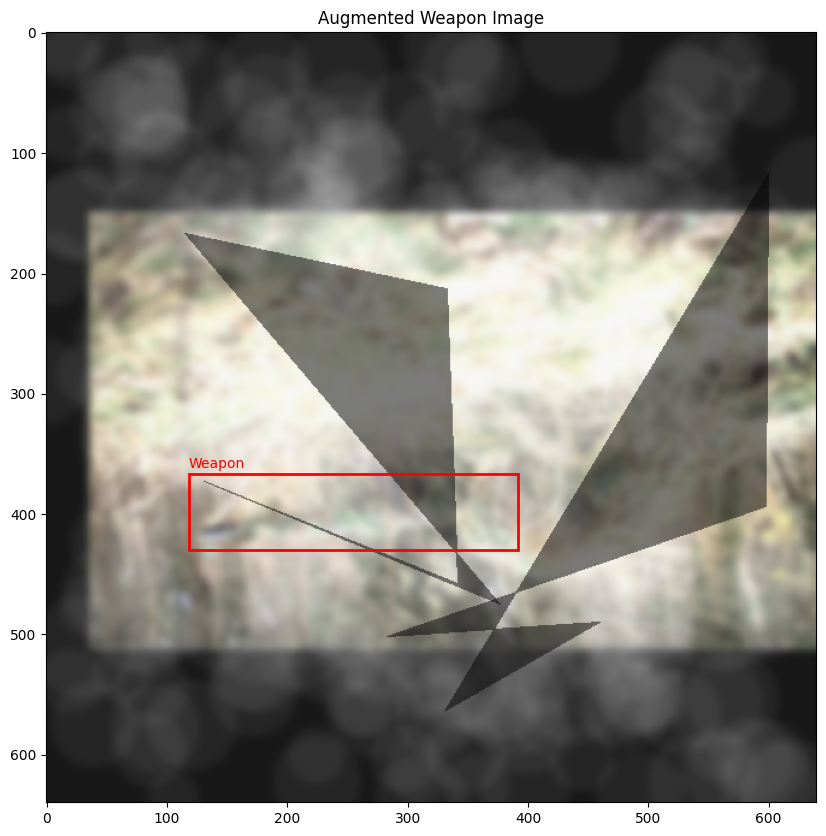

Augmenting Weapon:  53%|████████████████████████████████████████████████████████████                                                     | 249/468 [00:45<00:26,  8.37it/s]

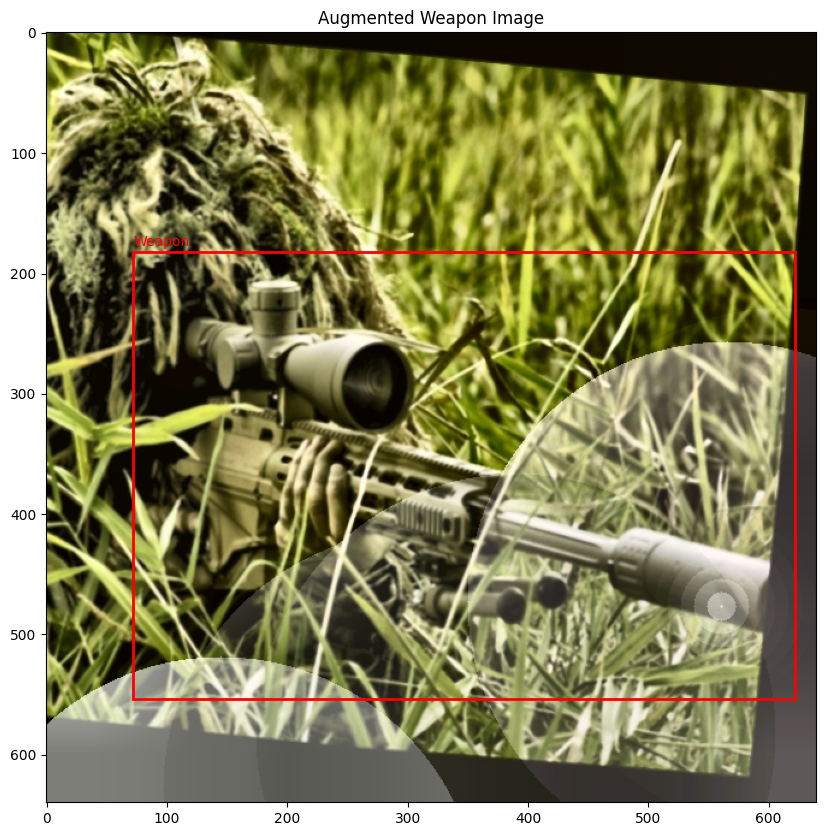

Augmenting Weapon:  64%|████████████████████████████████████████████████████████████████████████▍                                        | 300/468 [00:54<00:25,  6.47it/s]

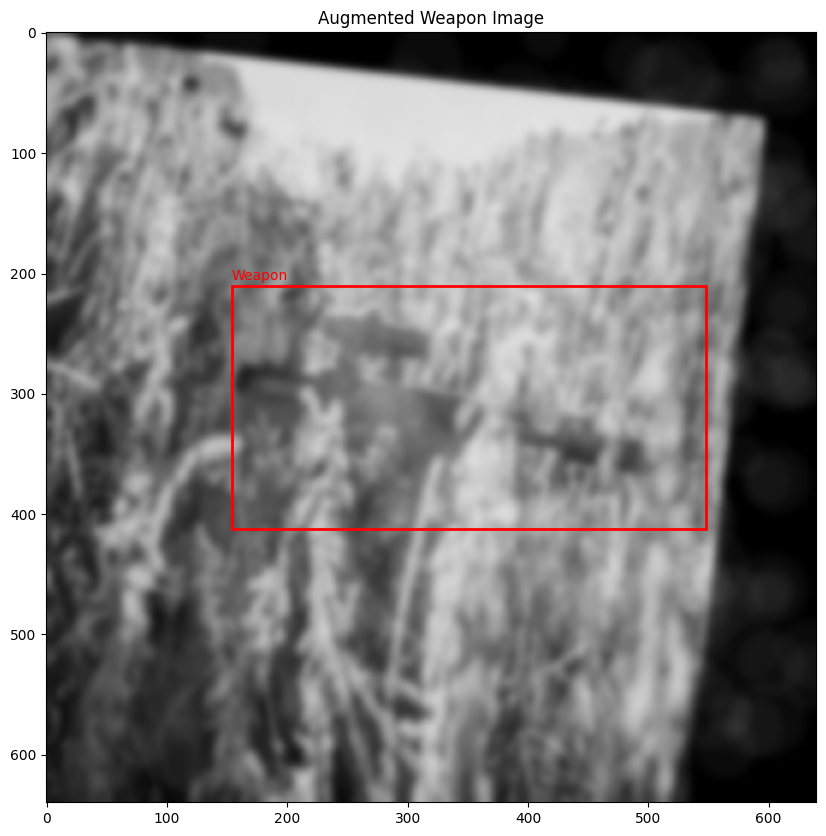

Augmenting Weapon:  75%|████████████████████████████████████████████████████████████████████████████████████▎                            | 349/468 [01:01<00:20,  5.86it/s]

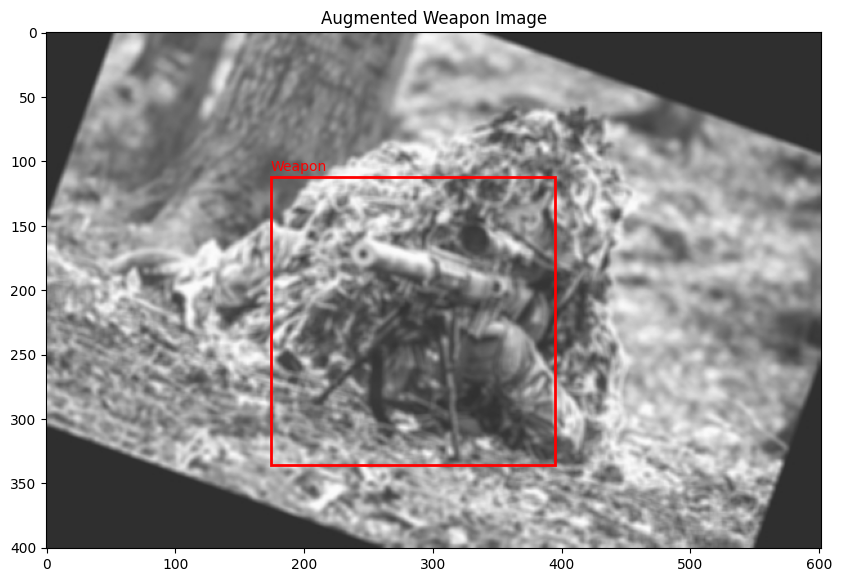

Augmenting Weapon:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▌                | 400/468 [01:07<00:10,  6.76it/s]

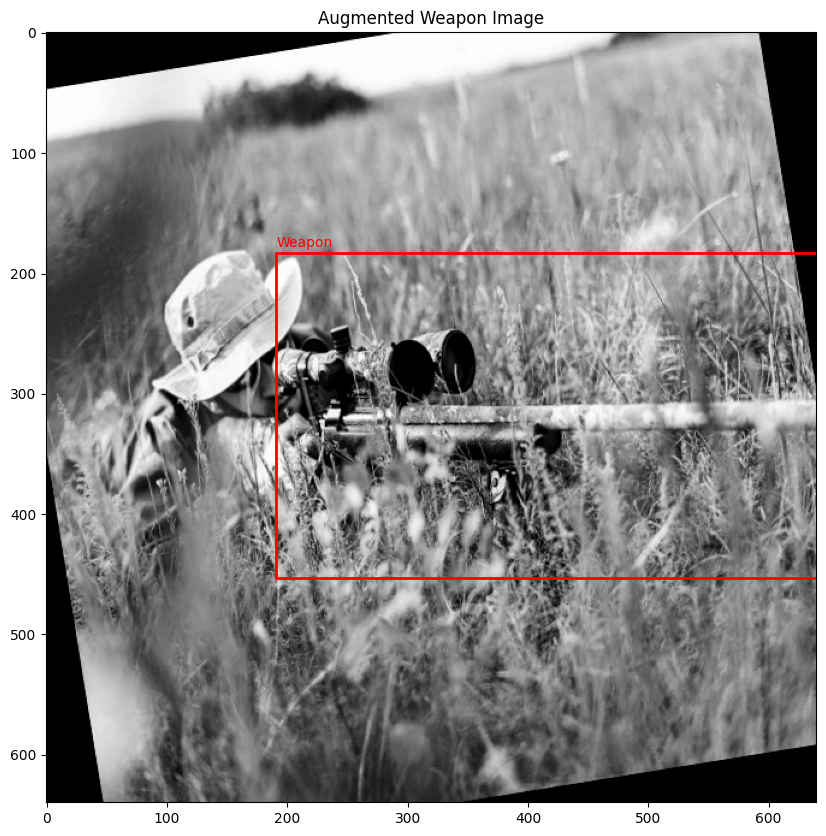

Augmenting Weapon:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 450/468 [01:14<00:03,  4.93it/s]

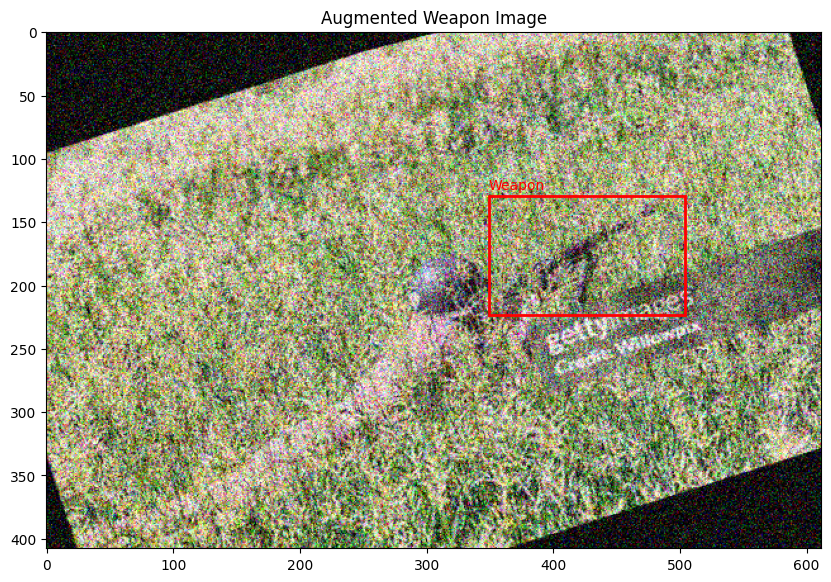

Augmenting Weapon: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 468/468 [01:17<00:00,  6.03it/s]


Generating 467 augmented images for class 'No Weapon'


Augmenting No Weapon:   0%|                                                                                                                        | 0/467 [00:00<?, ?it/s]

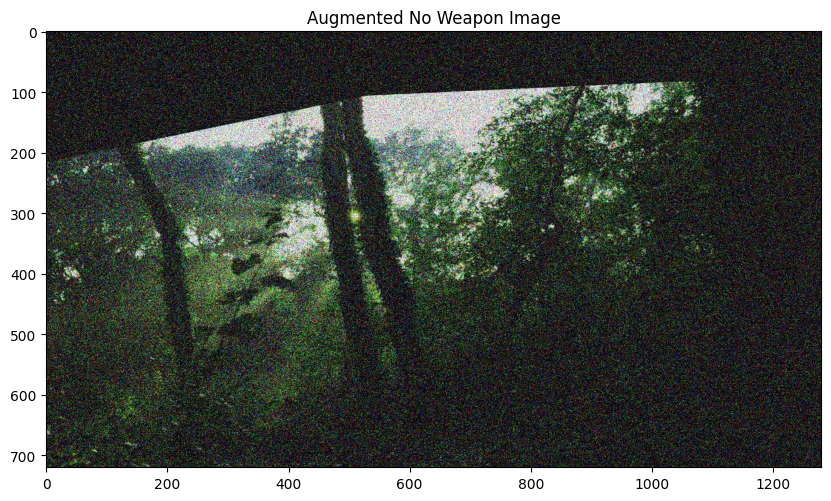

Augmenting No Weapon:  11%|███████████▉                                                                                                   | 50/467 [00:08<00:48,  8.59it/s]

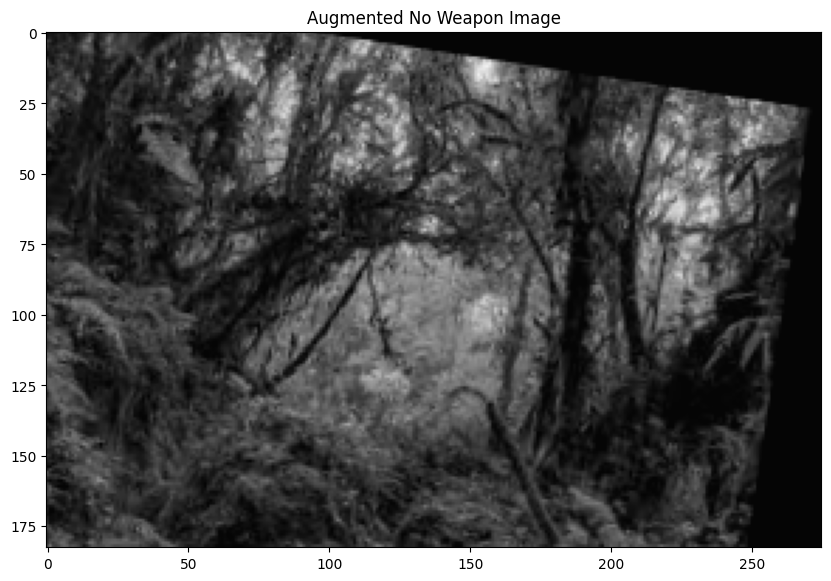

Augmenting No Weapon:  21%|███████████████████████▌                                                                                       | 99/467 [00:12<00:28, 12.87it/s]

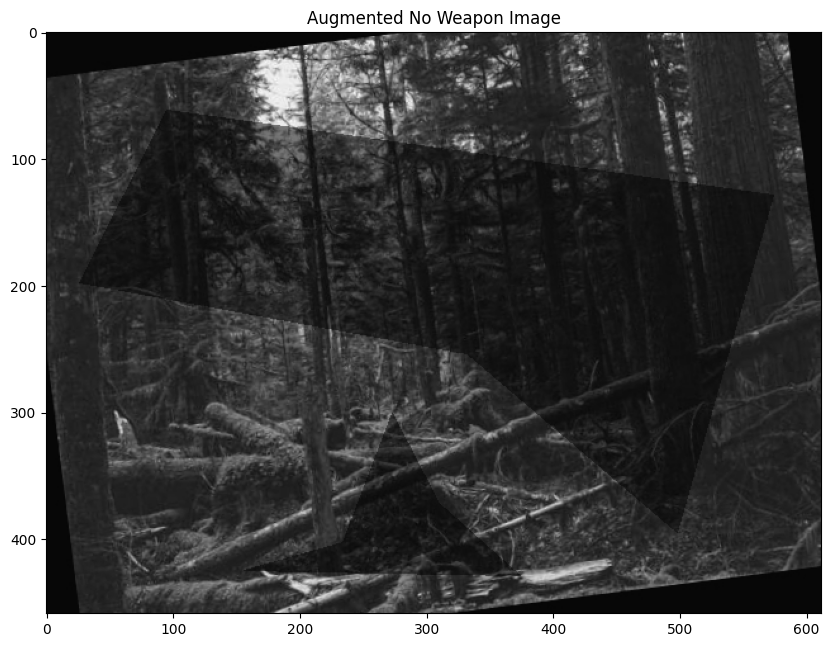

Augmenting No Weapon:  32%|███████████████████████████████████                                                                           | 149/467 [00:41<00:27, 11.44it/s]

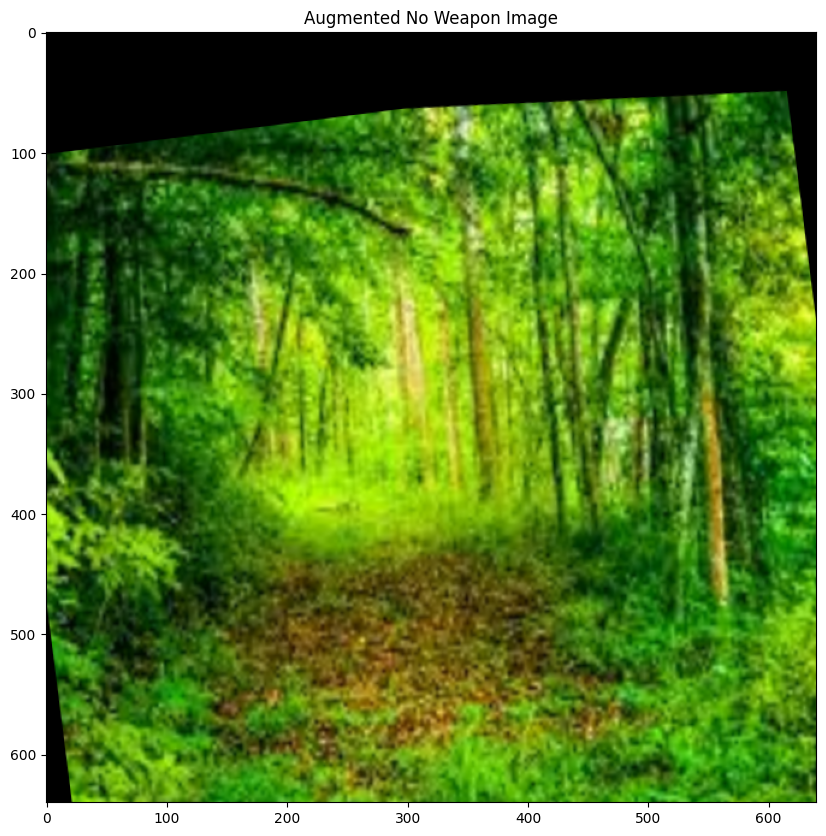

Augmenting No Weapon:  42%|██████████████████████████████████████████████▍                                                               | 197/467 [01:04<00:17, 15.19it/s]

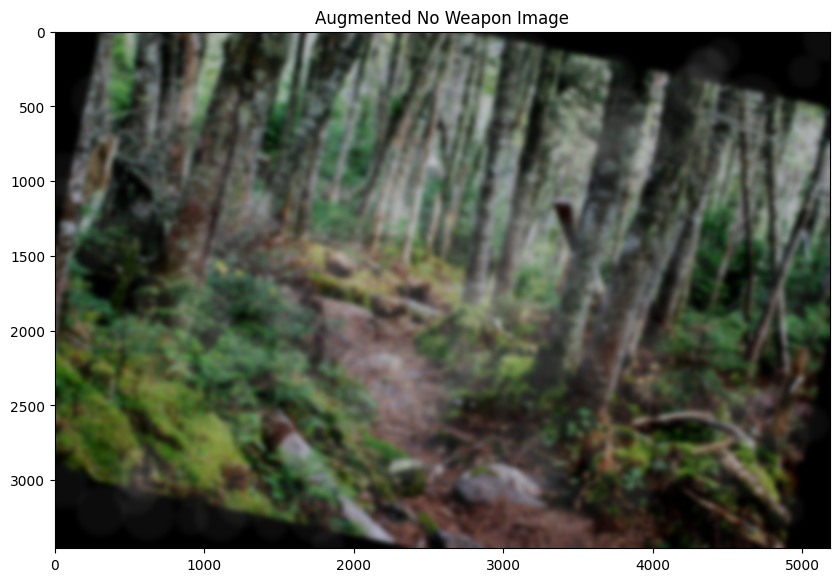

Augmenting No Weapon:  53%|██████████████████████████████████████████████████████████▋                                                   | 249/467 [01:10<00:14, 15.57it/s]

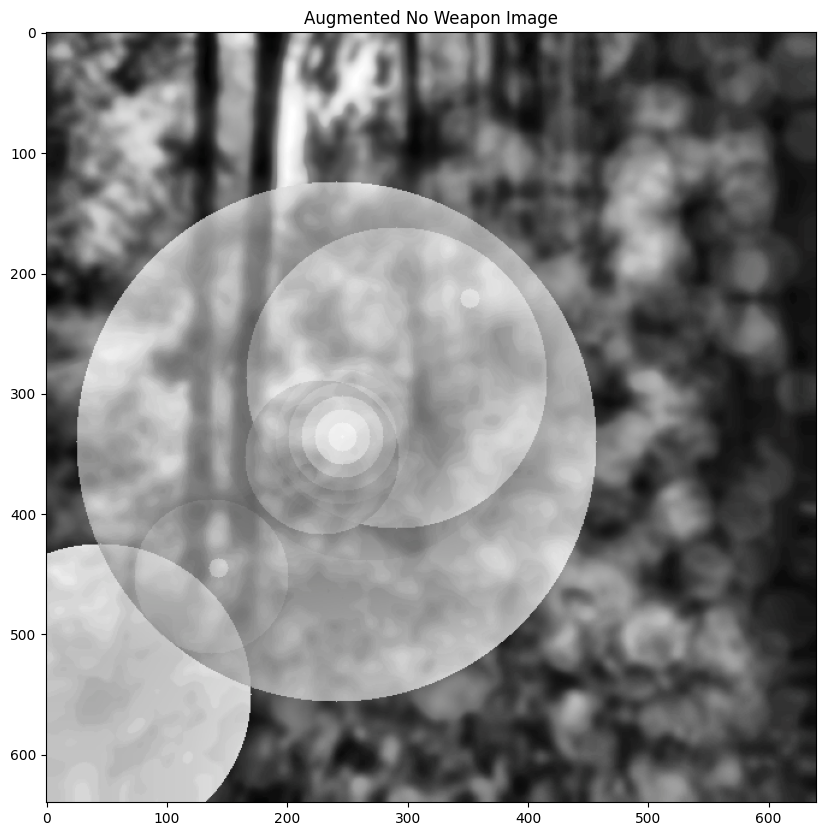

Augmenting No Weapon:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 300/467 [01:17<00:19,  8.56it/s]

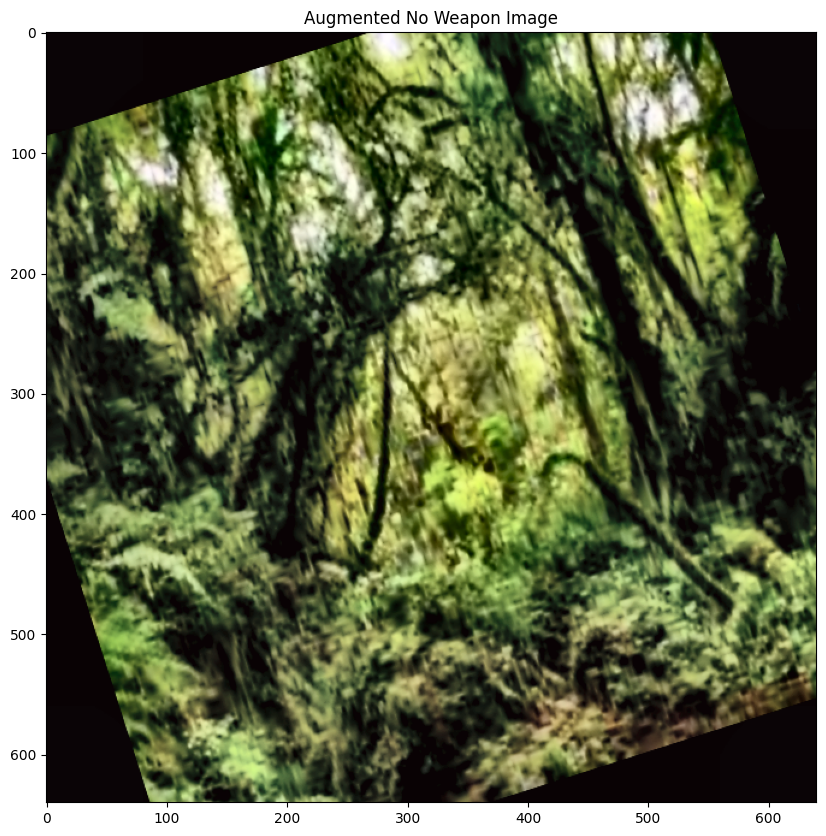

Augmenting No Weapon:  75%|██████████████████████████████████████████████████████████████████████████████████▍                           | 350/467 [01:46<00:23,  5.03it/s]

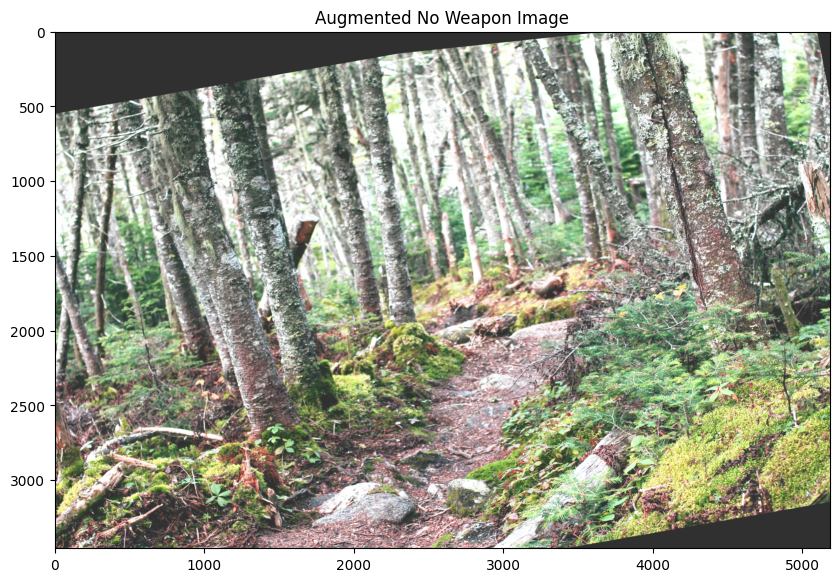

Augmenting No Weapon:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▏               | 400/467 [02:31<00:10,  6.56it/s]

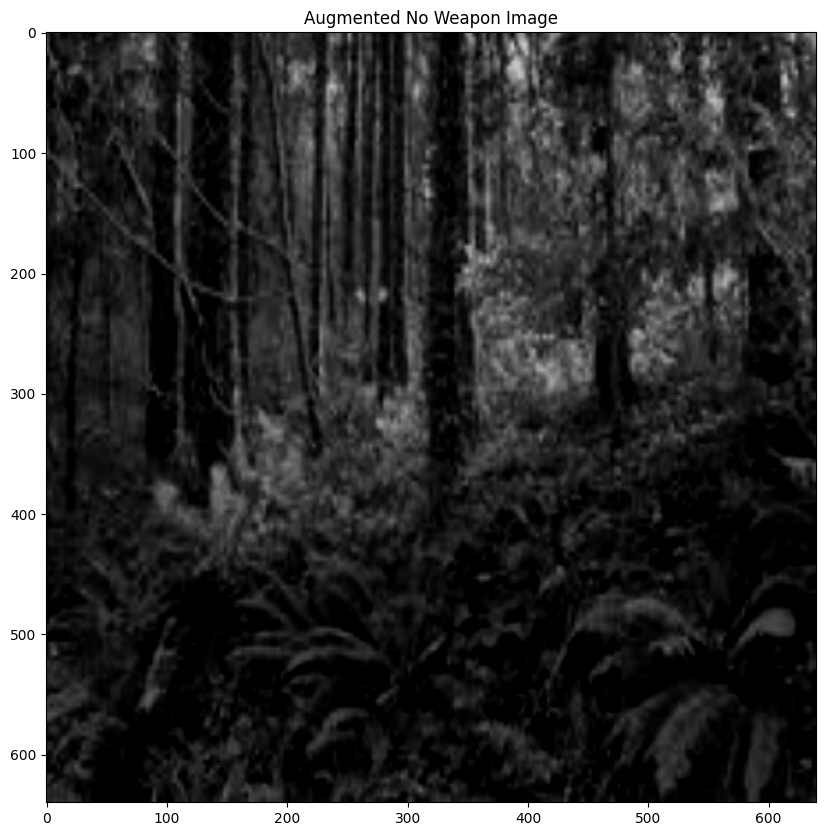

Augmenting No Weapon:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 448/467 [03:02<00:03,  5.27it/s]

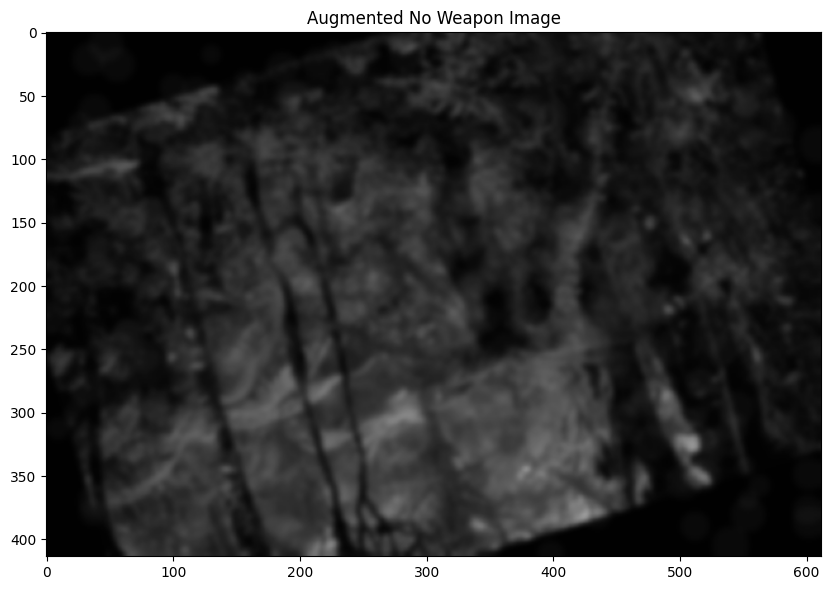

Augmenting No Weapon: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 467/467 [03:04<00:00,  2.52it/s]


Final dataset size: 1000 images

Step 4: Splitting dataset
Dataset split: 700 train, 200 validation, 100 test


Copying test files: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:01<00:00, 83.44it/s]


Step 5: Creating dataset.yaml
Created dataset.yaml at D:/projects_ml/Camouflage_Weapon_Detection\data\dataset.yaml

Step 6: Training YOLOv8 model



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6.25M/6.25M [00:01<00:00, 5.99MB/s]


Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=D:/projects_ml/Camouflage_Weapon_Detection\data\dataset.yaml, epochs=50, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=D:/projects_ml/Camouflage_Weapon_Detection\runs, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=Fa

train: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\train\labels... 700 images, 353 backgrounds, 0 corrupt: 100%|██████████| 700/700 [00:03<00:00, 221.

train: New cache created: D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\train\labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels... 200 images, 103 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<00:00, 295.47it

val: New cache created: D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels.cache


Plotting labels to D:\projects_ml\Camouflage_Weapon_Detection\runs\train\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to D:\projects_ml\Camouflage_Weapon_Detection\runs\train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      2.176      4.926      2.366          9        640: 100%|██████████| 44/44 [07:01<00:00,  9.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:45<00:00,  6.44s/it]

                   all        200        109    0.00371      0.752     0.0571     0.0182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      2.136      4.239      2.222         10        640: 100%|██████████| 44/44 [06:36<00:00,  9.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.08s/it]

                   all        200        109      0.122     0.0734     0.0314    0.00839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      2.219      3.899      2.348         12        640: 100%|██████████| 44/44 [05:51<00:00,  7.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.61s/it]

                   all        200        109      0.127      0.119       0.05      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G      2.211      3.679       2.36         12        640: 100%|██████████| 44/44 [05:56<00:00,  8.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:38<00:00,  5.49s/it]

                   all        200        109     0.0516      0.055      0.016    0.00374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      2.076       3.36      2.253          9        640: 100%|██████████| 44/44 [05:59<00:00,  8.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.15s/it]

                   all        200        109       0.12      0.128     0.0444     0.0111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      2.103      3.162       2.27         13        640: 100%|██████████| 44/44 [06:07<00:00,  8.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.36s/it]

                   all        200        109      0.185      0.166       0.13     0.0513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      2.019      2.899      2.179         15        640: 100%|██████████| 44/44 [06:09<00:00,  8.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.25s/it]

                   all        200        109      0.157      0.128     0.0886     0.0313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G      2.062      2.946      2.208         17        640: 100%|██████████| 44/44 [06:18<00:00,  8.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.23s/it]

                   all        200        109     0.0977      0.193      0.062     0.0157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G      1.989      2.815      2.169         11        640: 100%|██████████| 44/44 [07:08<00:00,  9.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.12s/it]

                   all        200        109     0.0914      0.165      0.061     0.0213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G      1.988      2.759       2.16         15        640: 100%|██████████| 44/44 [06:09<00:00,  8.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:40<00:00,  5.75s/it]

                   all        200        109      0.321      0.275      0.218     0.0714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      1.929      2.658      2.143          9        640: 100%|██████████| 44/44 [07:11<00:00,  9.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:47<00:00,  6.75s/it]

                   all        200        109      0.294      0.266      0.265     0.0984



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G      1.915      2.584      2.143         10        640: 100%|██████████| 44/44 [07:36<00:00, 10.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.89s/it]

                   all        200        109      0.292      0.312       0.23     0.0906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G       1.83      2.466      2.046         10        640: 100%|██████████| 44/44 [07:31<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.88s/it]

                   all        200        109      0.377      0.385       0.31      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      1.867      2.479      2.089          6        640: 100%|██████████| 44/44 [07:22<00:00, 10.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.21s/it]

                   all        200        109      0.407      0.447      0.353      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G      1.806       2.34      2.045         12        640: 100%|██████████| 44/44 [06:54<00:00,  9.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.87s/it]

                   all        200        109      0.393      0.367      0.335      0.128



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G      1.812      2.254      2.042         22        640: 100%|██████████| 44/44 [06:59<00:00,  9.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:40<00:00,  5.83s/it]

                   all        200        109      0.494      0.459      0.481      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G      1.748      2.248      1.957         20        640: 100%|██████████| 44/44 [06:51<00:00,  9.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.67s/it]

                   all        200        109      0.531       0.45      0.469      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G      1.743       2.24      1.985         16        640: 100%|██████████| 44/44 [06:53<00:00,  9.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.14s/it]

                   all        200        109      0.536      0.486      0.505      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G      1.736      2.146      1.959         12        640: 100%|██████████| 44/44 [06:16<00:00,  8.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.62s/it]

                   all        200        109      0.599      0.477      0.508      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      1.643      2.074      1.891         16        640: 100%|██████████| 44/44 [07:12<00:00,  9.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:43<00:00,  6.19s/it]

                   all        200        109      0.503      0.473      0.468      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G      1.666      2.057      1.913         15        640: 100%|██████████| 44/44 [07:36<00:00, 10.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.24s/it]

                   all        200        109      0.595      0.486       0.56      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G      1.598       1.93      1.845         13        640: 100%|██████████| 44/44 [06:56<00:00,  9.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:38<00:00,  5.57s/it]

                   all        200        109      0.507      0.587      0.568       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G      1.613      1.932      1.844         10        640: 100%|██████████| 44/44 [06:31<00:00,  8.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:38<00:00,  5.50s/it]

                   all        200        109      0.682      0.505       0.61      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G      1.601      1.895      1.889         15        640: 100%|██████████| 44/44 [06:33<00:00,  8.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.58s/it]

                   all        200        109      0.739      0.578      0.618      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G       1.54       1.81      1.797         22        640: 100%|██████████| 44/44 [06:33<00:00,  8.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.59s/it]

                   all        200        109      0.676      0.532      0.593      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G      1.547      1.802      1.802         18        640: 100%|██████████| 44/44 [06:36<00:00,  9.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.58s/it]

                   all        200        109      0.699      0.597      0.692      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G       1.57      1.828      1.816         15        640: 100%|██████████| 44/44 [06:50<00:00,  9.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.68s/it]

                   all        200        109      0.606       0.55      0.623      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      1.528      1.735      1.779          9        640: 100%|██████████| 44/44 [07:34<00:00, 10.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:38<00:00,  5.53s/it]

                   all        200        109      0.767      0.664      0.749       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G      1.465      1.701      1.756         10        640: 100%|██████████| 44/44 [06:45<00:00,  9.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.58s/it]

                   all        200        109      0.709      0.697      0.744      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G      1.463      1.686      1.712          9        640: 100%|██████████| 44/44 [07:29<00:00, 10.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.70s/it]

                   all        200        109      0.818      0.679      0.785      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G      1.467      1.672       1.72         20        640: 100%|██████████| 44/44 [06:59<00:00,  9.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.40s/it]

                   all        200        109      0.813      0.716      0.786      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G      1.411      1.705      1.698         12        640: 100%|██████████| 44/44 [06:23<00:00,  8.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.40s/it]

                   all        200        109      0.661      0.607      0.695       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      1.409      1.614      1.698         14        640: 100%|██████████| 44/44 [06:42<00:00,  9.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.30s/it]

                   all        200        109      0.811       0.75      0.806      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G      1.391       1.59      1.651         15        640: 100%|██████████| 44/44 [06:21<00:00,  8.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.33s/it]

                   all        200        109      0.734      0.752      0.795      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G      1.404      1.563      1.662         18        640: 100%|██████████| 44/44 [06:45<00:00,  9.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:39<00:00,  5.60s/it]

                   all        200        109      0.833      0.771      0.848      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G      1.392      1.578      1.678         16        640: 100%|██████████| 44/44 [06:59<00:00,  9.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.90s/it]

                   all        200        109      0.804      0.761      0.839      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G       1.32      1.518      1.612         23        640: 100%|██████████| 44/44 [07:03<00:00,  9.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.96s/it]

                   all        200        109      0.846      0.809      0.857      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      1.328      1.423      1.616         15        640: 100%|██████████| 44/44 [07:06<00:00,  9.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.97s/it]

                   all        200        109      0.907      0.806      0.866      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      1.318      1.462      1.599         11        640: 100%|██████████| 44/44 [07:01<00:00,  9.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.90s/it]

                   all        200        109      0.958      0.771      0.885      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G      1.254      1.399      1.552          6        640: 100%|██████████| 44/44 [07:09<00:00,  9.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:43<00:00,  6.16s/it]

                   all        200        109      0.887      0.794      0.884      0.502


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G      1.277      1.292      1.683          6        640: 100%|██████████| 44/44 [06:25<00:00,  8.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.37s/it]

                   all        200        109      0.915      0.793      0.893       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G      1.151      1.162      1.588          3        640: 100%|██████████| 44/44 [07:53<00:00, 10.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:48<00:00,  6.99s/it]

                   all        200        109      0.874      0.826      0.891      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G      1.156      1.089      1.568          7        640: 100%|██████████| 44/44 [10:35<00:00, 14.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:48<00:00,  6.95s/it]

                   all        200        109      0.907      0.892      0.915      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G      1.144      1.007      1.528          8        640: 100%|██████████| 44/44 [09:02<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:50<00:00,  7.26s/it]

                   all        200        109      0.942      0.862      0.923       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G      1.142     0.9848      1.525          7        640: 100%|██████████| 44/44 [09:13<00:00, 12.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.63s/it]

                   all        200        109      0.953      0.844      0.917      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G      1.083     0.9637      1.476          4        640: 100%|██████████| 44/44 [09:39<00:00, 13.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:46<00:00,  6.71s/it]

                   all        200        109      0.945      0.844      0.908       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G      1.095     0.9483      1.483          2        640: 100%|██████████| 44/44 [08:14<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:46<00:00,  6.62s/it]

                   all        200        109      0.957      0.862      0.928      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G      1.048     0.9549      1.449          7        640: 100%|██████████| 44/44 [08:28<00:00, 11.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:42<00:00,  6.04s/it]

                   all        200        109      0.939      0.853      0.909      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G      1.026     0.9256      1.419         12        640: 100%|██████████| 44/44 [07:31<00:00, 10.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:42<00:00,  6.09s/it]

                   all        200        109      0.913      0.872       0.92      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G      1.027     0.9135      1.435          6        640: 100%|██████████| 44/44 [06:58<00:00,  9.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:41<00:00,  5.90s/it]

                   all        200        109       0.92      0.872       0.92      0.589



50 epochs completed in 6.510 hours.
Optimizer stripped from D:\projects_ml\Camouflage_Weapon_Detection\runs\train\weights\last.pt, 6.2MB
Optimizer stripped from D:\projects_ml\Camouflage_Weapon_Detection\runs\train\weights\best.pt, 6.2MB

Validating D:\projects_ml\Camouflage_Weapon_Detection\runs\train\weights\best.pt...
Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:38<00:00,  5.45s/it]


                   all        200        109      0.916      0.872       0.92      0.603
                Weapon         97        109      0.916      0.872       0.92      0.603
Speed: 4.0ms preprocess, 171.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to D:\projects_ml\Camouflage_Weapon_Detection\runs\train
Training completed. Results saved to D:/projects_ml/Camouflage_Weapon_Detection\runs\train

Step 7: Testing model
Could not find best.pt, using latest.pt
No trained model found. Using default YOLOv8n.
Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
YOLOv8n summary (fused): 72 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs


val: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels.cache... 200 images, 103 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:32<00:00,  2.51s/it]


                   all        200        109      0.084     0.0367     0.0179    0.00433
                person         97        109      0.084     0.0367     0.0179    0.00433
Speed: 1.9ms preprocess, 147.4ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs\detect\val
Validation results: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000225B206B970>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024, 

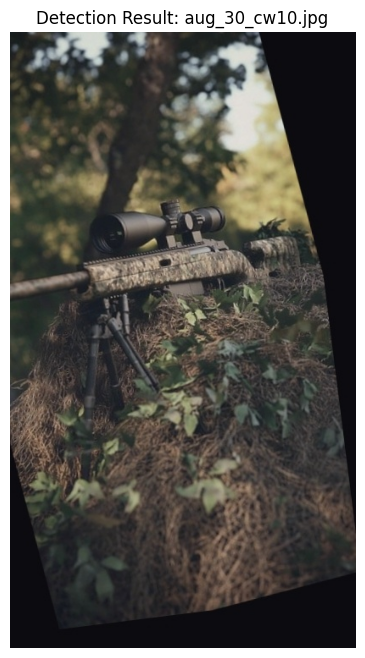


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_115_ns9.jpg: 640x640 (no detections), 212.3ms
Speed: 4.2ms preprocess, 212.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


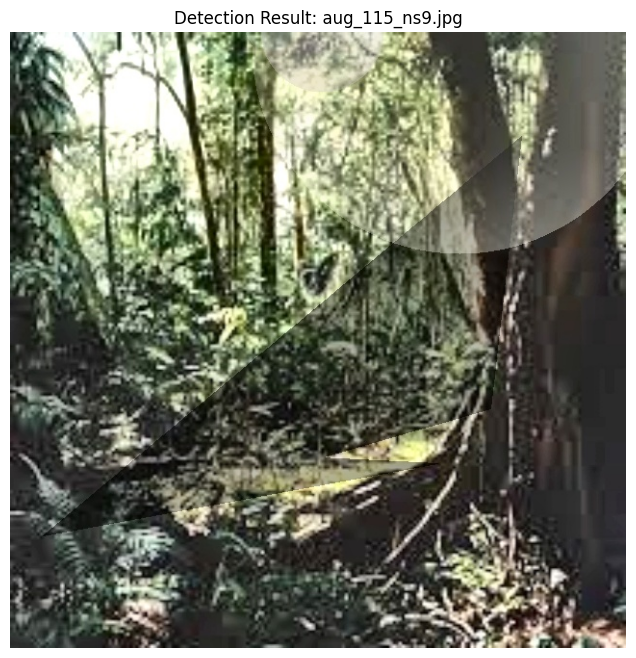


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_6_cw23.jpg: 640x640 (no detections), 174.1ms
Speed: 3.2ms preprocess, 174.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


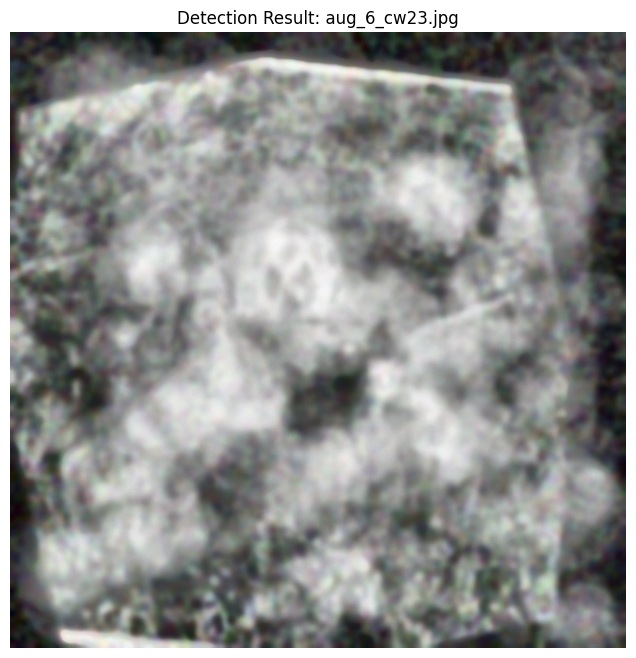


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_401_ns26.jpg: 640x448 (no detections), 159.9ms
Speed: 3.2ms preprocess, 159.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)


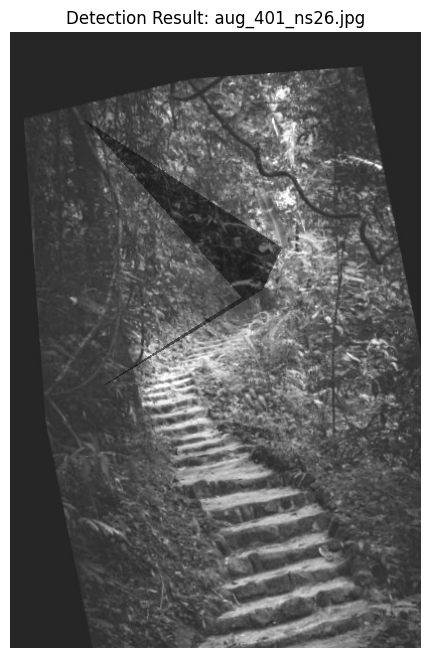


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_246_cw5.png: 640x640 (no detections), 169.0ms
Speed: 3.0ms preprocess, 169.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


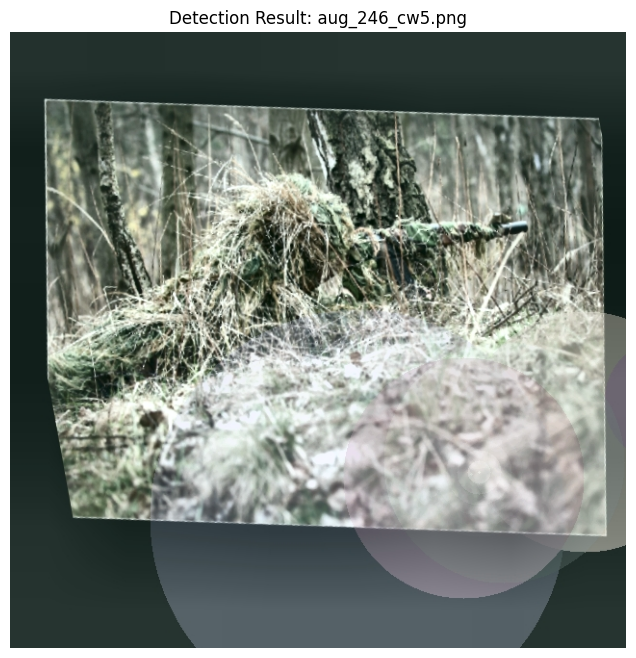


Pipeline completed successfully!
Could not find best.pt, using last.pt
No trained model found. Using default YOLOv8n.
Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
YOLOv8n summary (fused): 72 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs


val: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels.cache... 200 images, 103 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:26<00:00,  2.04s/it]


                   all        200        109      0.084     0.0367     0.0179    0.00433
                person         97        109      0.084     0.0367     0.0179    0.00433
Speed: 1.5ms preprocess, 120.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs\detect\val2

Model Evaluation Metrics:
mAP50: 0.0179
mAP50-95: 0.0043


TypeError: unsupported format string passed to numpy.ndarray.__format__

In [39]:
if __name__ == "__main__":
    # Run the full pipeline
    run_full_pipeline(augment_to=500, train_epochs=50)
    
    # Evaluate the model
    evaluate_model()
    
    # Run detection on test set
    test_model()

Found trained model: D:/projects_ml/Camouflage_Weapon_Detection\runs\train\weights\best.pt
Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels.cache... 200 images, 103 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:22<00:00,  1.74s/it]


                   all        200        109      0.919      0.881       0.92      0.603
                Weapon         97        109      0.919      0.881       0.92      0.603
Speed: 1.4ms preprocess, 102.3ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\val3
Validation results: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000225DF672AC0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,

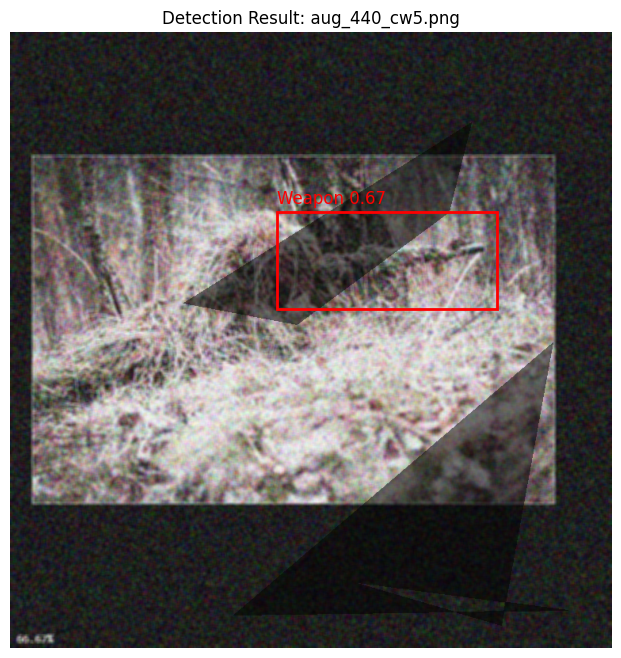


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_244_cw17.jpg: 640x640 1 Weapon, 147.9ms
Speed: 2.1ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


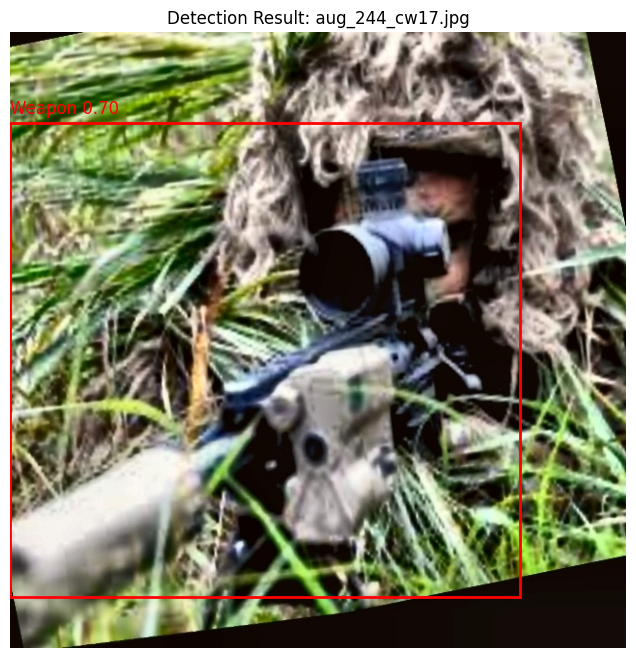


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_97_cw28.jpg: 640x640 1 Weapon, 146.0ms
Speed: 2.8ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


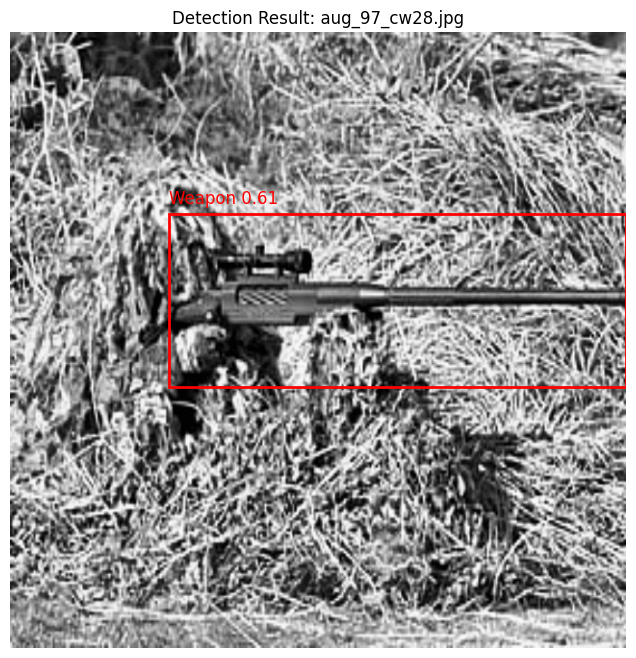


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_105_cw13.jpg: 640x640 1 Weapon, 154.1ms
Speed: 2.7ms preprocess, 154.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


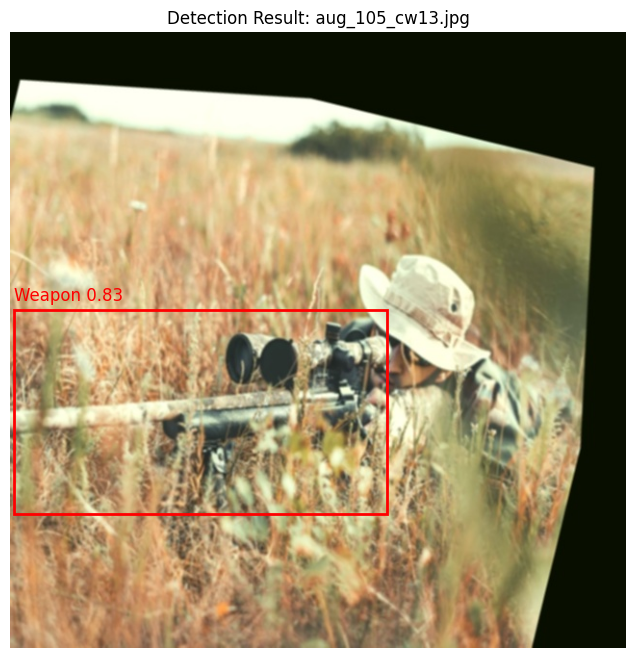


image 1/1 D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\test\images\aug_194_ns10.jpg: 448x640 (no detections), 256.3ms
Speed: 2.1ms preprocess, 256.3ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)


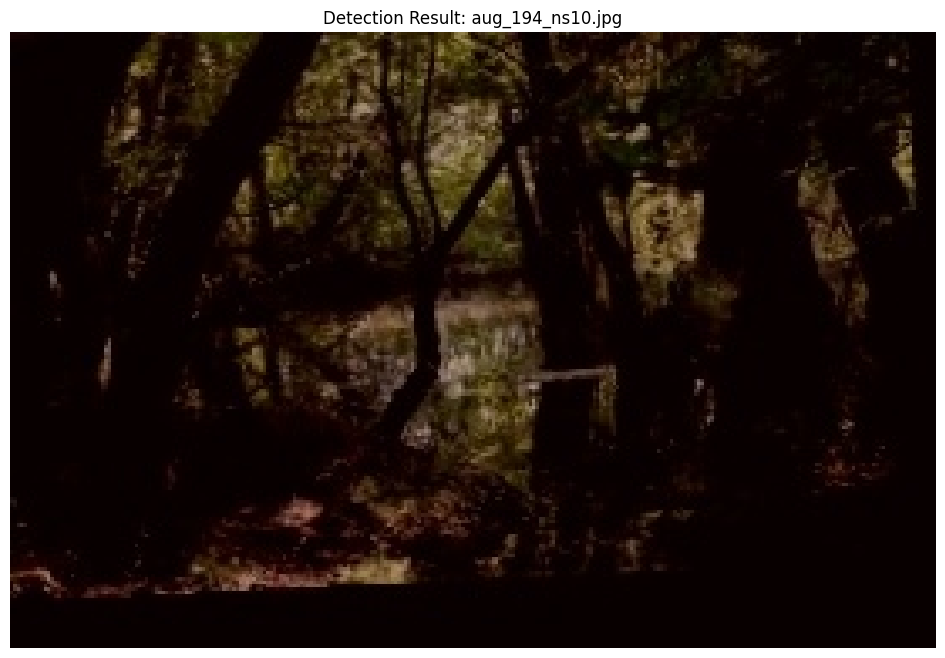

In [41]:
test_model()

In [44]:
evaluate_model()

Found trained model: D:/projects_ml/Camouflage_Weapon_Detection\runs\train\weights\best.pt
Ultralytics 8.3.90  Python-3.9.13 torch-2.6.0+cpu CPU (Intel Core(TM) i3-10110U 2.10GHz)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning D:\projects_ml\Camouflage_Weapon_Detection\data\dataset\val\labels.cache... 200 images, 103 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:22<00:00,  1.77s/it]


                   all        200        109      0.919      0.881       0.92      0.603
                Weapon         97        109      0.919      0.881       0.92      0.603
Speed: 1.4ms preprocess, 104.2ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\val5

Model Evaluation Metrics:
mAP50: 0.9202
mAP50-95: 0.6035


TypeError: unsupported format string passed to numpy.ndarray.__format__